# Time-optimal trajectory planning
Solve time-optimal trajectory planning problems using the Dabry module

In [1]:
from dabry.problem import NavigationProblem
from dabry.solver_display import display
from dabry.solver_ef import SolverEFResampling

## Creating and visualizing a problem

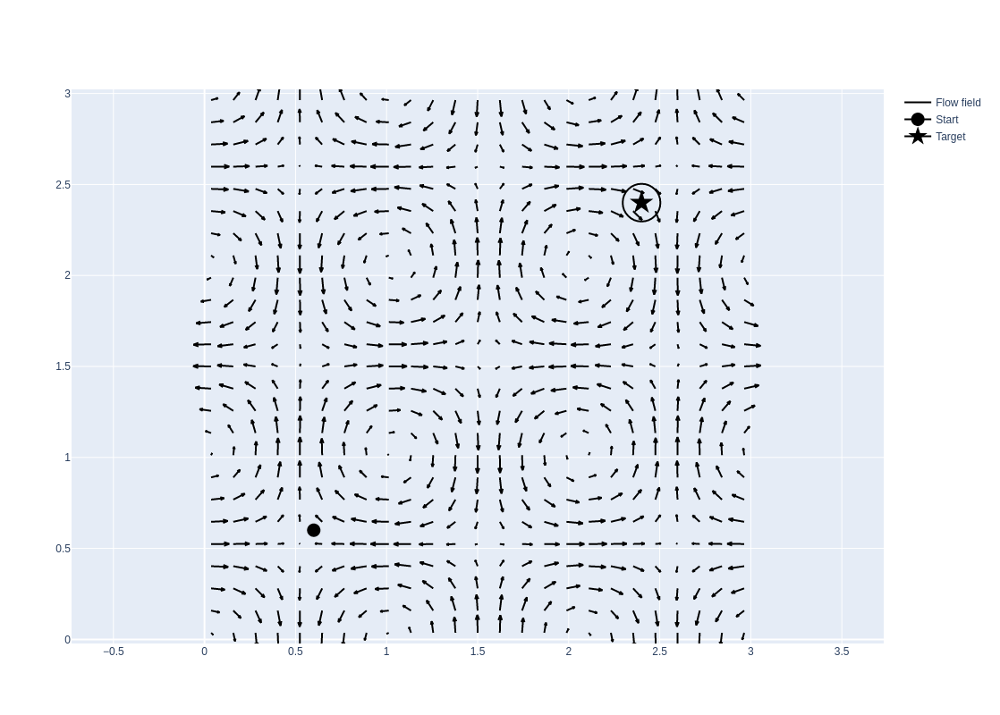

In [2]:
# Instantiation of pre-defined problem
# Complete list in "problems.csv"
pb = NavigationProblem.from_name('gyre')

# Creation of the solver
solver = SolverEFResampling(pb)

# Visual representation of the navigation problem
fig, _ = display(solver)
fig.show()

## Running the solver

In [3]:
solver.solve()
print(solver.success)

Depth 14: 100%|████████████████████████████████| 16/16 [00:00<00:00, 704.41it/s]
Depth 15: 0it [00:00, ?it/s]
Depth 16: 0it [00:00, ?it/s]
Depth 17: 0it [00:00, ?it/s]
Depth 18: 0it [00:00, ?it/s]
Depth 19: 0it [00:00, ?it/s]

True


## Visualizing results

### Planar representation

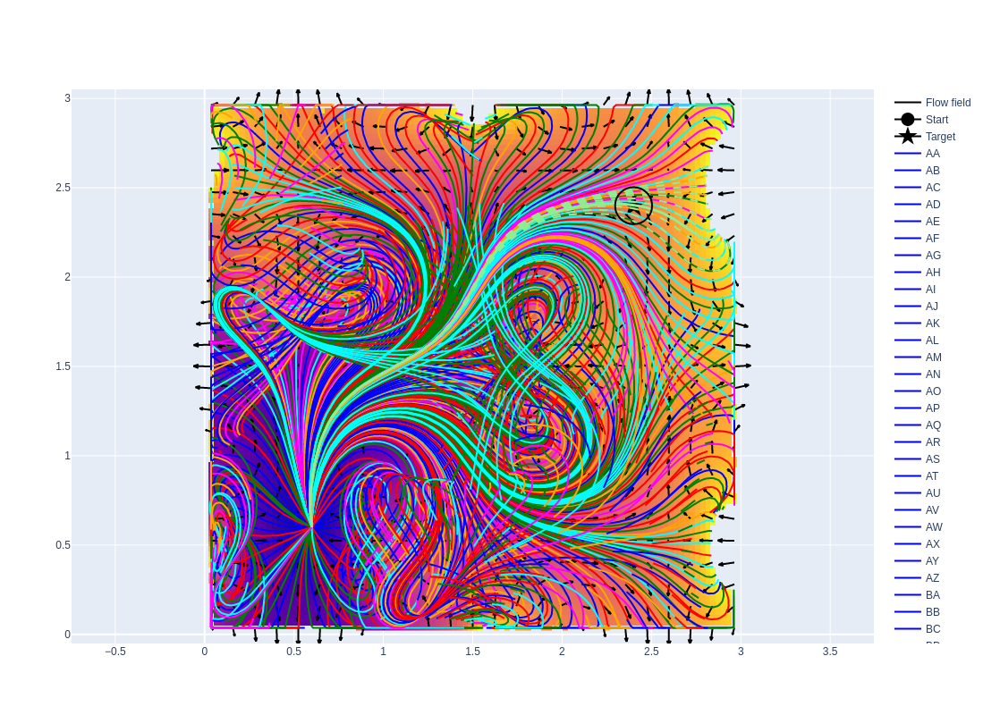

In [4]:
fig, fig3d = display(solver)
fig.show()

### State-cost space representation

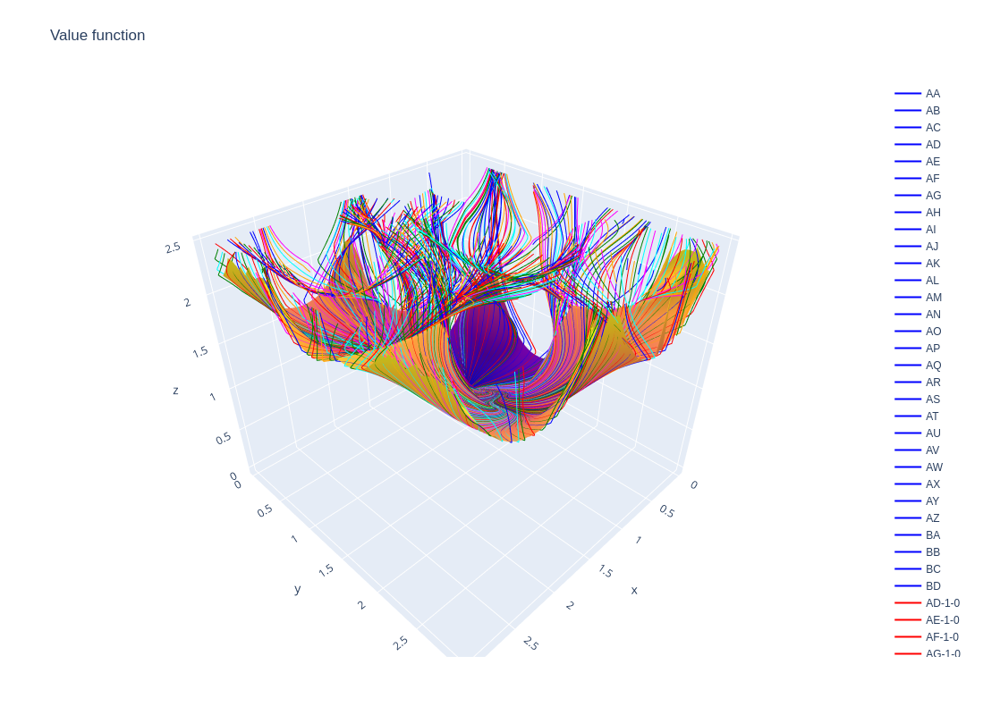

In [5]:
fig3d.show()

## Explanations on the solver's behavior

A *step* is a forward integration of a set of extremals up to the end of the work time window.

The problem's value function, *i.e.* the optimal travel time from origin to any point in space (shown as a color grid) is assumed to be known when neighbour extremals are close to one another.

Depth 0: 100%|██████████████████████████████████| 30/30 [00:00<00:00, 92.01it/s]


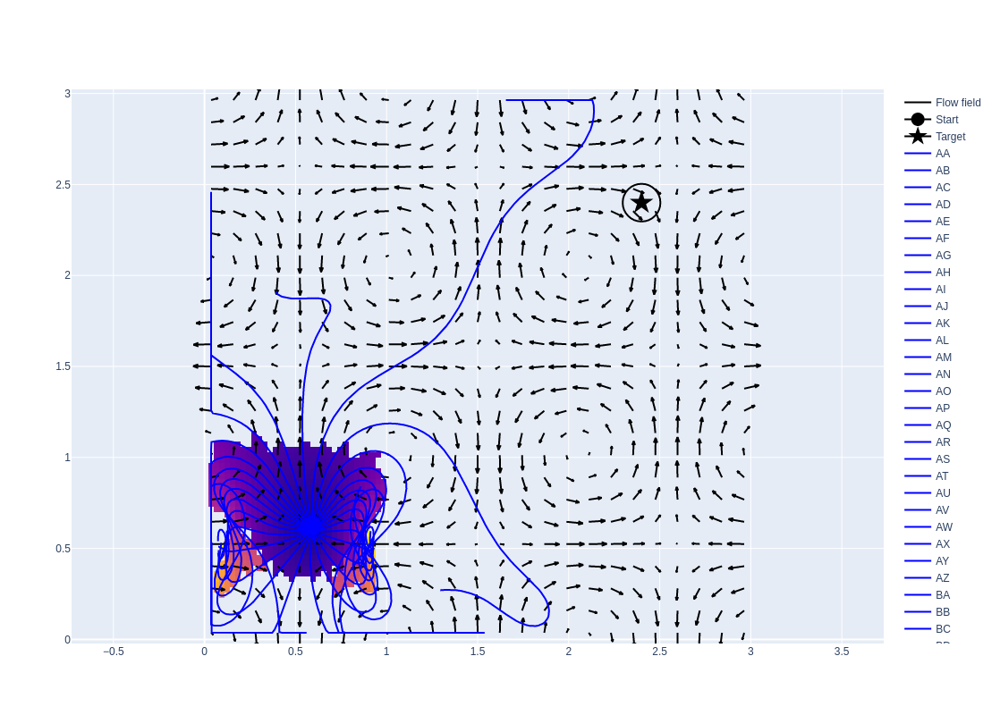

In [6]:
solver = SolverEFResampling(pb)
solver.setup()
solver.step()
fig, _ = display(solver)
fig.show()

To propagate the knowledge of the value function forward, the solver samples new extremals with an averaged initial condition between neighbour extremals.

Depth 1: 100%|██████████████████████████████████| 20/20 [00:00<00:00, 79.95it/s]


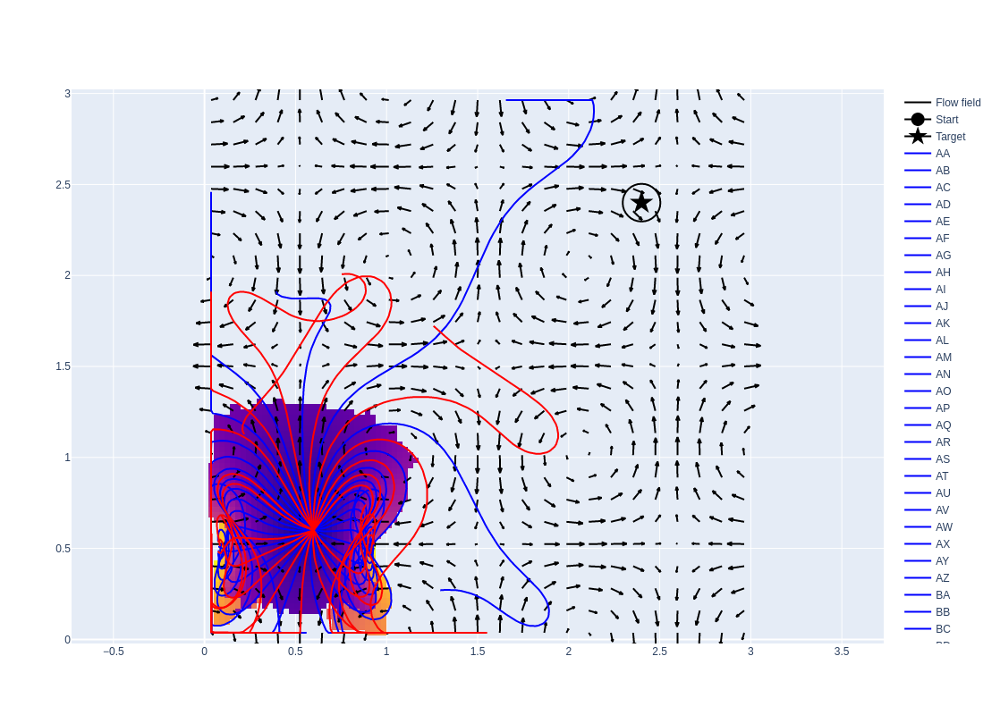

In [7]:
solver.step()
fig, _ = display(solver)
fig.show()

The procedure goes on until either:
 - the value function is totally built up to the required precision on the whole time window
   
   OR
 - the maximum depth of resampling is reached

Depth 14: 100%|████████████████████████████████| 16/16 [00:00<00:00, 670.08it/s]
Depth 15: 0it [00:00, ?it/s]
Depth 16: 0it [00:00, ?it/s]
Depth 17: 0it [00:00, ?it/s]
Depth 18: 0it [00:00, ?it/s]
Depth 19: 0it [00:00, ?it/s]


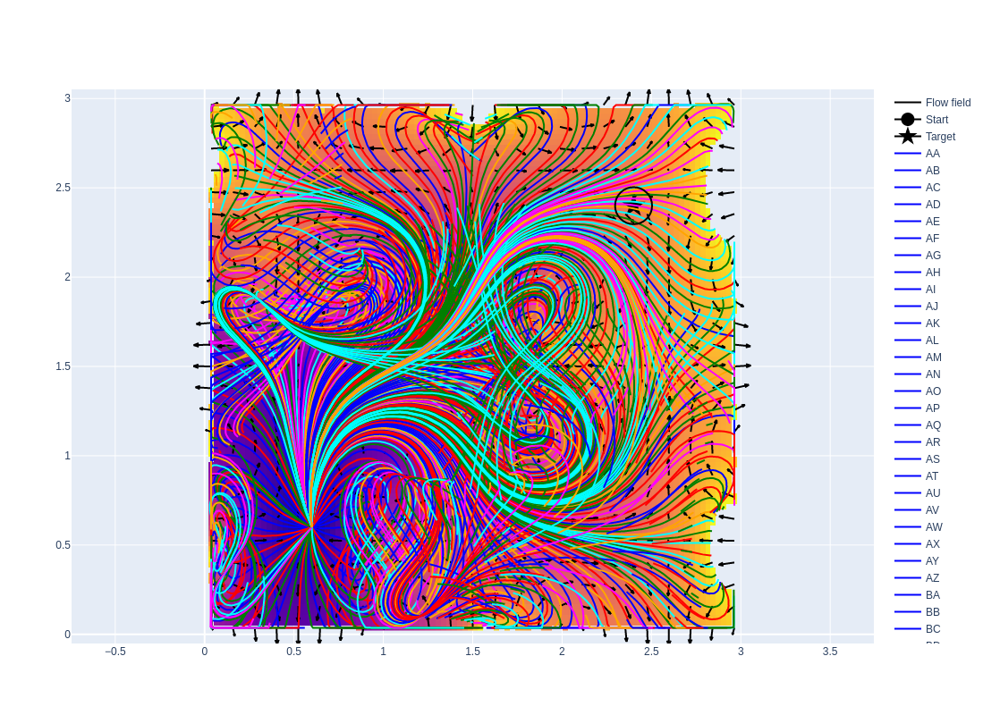

In [8]:
while solver.depth < solver.max_depth:
    solver.step()
fig, _ = display(solver)
fig.show()